# Reproducing Balaban Exp2 CDA Study (2019)
## Looking at Channels

In [2]:
import numpy as np
import pandas as pd
import glob
import pickle

import mne
from mne import Epochs, pick_channels, find_events
from mne.io import read_raw_bdf

import sys
sys.path.append('/Users/nick/Documents/PhD/CLCT/reprod/studies/Balaban-2019/')
from events import get_specific_events, checksum_epochs

import matplotlib
import matplotlib.pyplot as plt
%matplotlib inline

## 1. Prep Data

In [7]:
#==================================================================
# General Variables
#==================================================================
# Organize Triggers
triggers = dict();

triggers['2_Int'] = [21] 
triggers['4_Int'] = [22]
triggers['Sep'] = [23]

triggers['left'] = [31]
triggers['right'] = [32]

triggers['good'] = [50,60]   # YR: Why 2 triggers for good and 2 triggers for bad?!
triggers['bad'] = [5,6]

# Labels
conds = ['2_Int', '4_Int', 'Sep']
sides = ['left', 'right']
perfs = ['good', 'bad']

# # CDA Channels
chan_right = ['P8', 'PO8', 'PO4']
chan_left = ['P7', 'PO7', 'PO3']

# # CDA main variable!
cda_dict = dict()
epochs_all = dict()

#==================================================================
# Main Loop - Loading All Files & Extract CDAs.
#==================================================================
folderpath = '/Users/nick/Documents/PhD/CDA Datasets/Balaban 2019/Data/Exp2_EEG/'
#folderpath = 'D:\\CLNT\\Data\\Open Datasets\\Balaban 2019\\Data\\Exp2_EEG\\'
#filepath = folderpath + '536.bdf'
foldersep = '/'

for filepath in glob.iglob(folderpath + '*.bdf'):
    file_name = filepath[filepath.rfind(foldersep)+1:]
    print('Processing: ' + file_name + '...')

    # ------------------------
    # 1. -- Load File --
    # ------------------------
    raw = read_raw_bdf(filepath, preload=True)
    
    # ------------------------
    # 2. -- Preprocessing --
    # ------------------------
    # Keep only EEG channels and reference
    #raw = raw.rename_channels({'EXG7':'A1', 'EXG8': 'A2'})
    raw = raw.drop_channels(ch_names=['EXG3','EXG4','EXG5','EXG6', 'EXG7','EXG8',])
    raw = raw.set_eeg_reference(ref_channels=['EXG1', 'EXG2'])
    raw = raw.set_channel_types({'EXG1': 'misc', 'EXG2': 'misc'})

    # Set Electrodes Locations
    #montage = mne.channels.make_standard_montage('biosemi32')
    #raw.set_montage(montage)

    preproc = raw

    # Resample
    #preproc = preproc.resample(1024)

    # Filter
    preproc = preproc.filter(.1, 30., fir_design='firwin', skip_by_annotation='edge')

    events = find_events(preproc)
    #preproc.plot(events=events, block=True, lowpass=40)
    
    # ------------------------
    # 3. -- Epochs --
    # ------------------------
    # Get events based on conditions, sides (L/R) and performances
    # Code available in events.py
    specific_events = get_specific_events(events, conds, sides, perfs, triggers)

    epoch_length = 1.7
    epoch_tmin = -0.2
    baseline_corr = (-0.2, 0)

    print("====================== EPOCHING ======================")
    print("tmin:{}, tmax:{}, baseline={}".format(epoch_tmin, epoch_length, baseline_corr))
    
    epochs_dict = dict()
    for cur_cond in specific_events.keys():
        epochs_dict[cur_cond] = dict()

        for cur_side in specific_events[cur_cond].keys():
            epochs_dict[cur_cond][cur_side] = dict()

            for cur_perf in specific_events[cur_cond][cur_side].keys():
                print('---------- {}-{}-{} -------------'.format(cur_cond, cur_side, cur_perf))

                if(len(specific_events[cur_cond][cur_side][cur_perf]) > 0):
                    epochs_dict[cur_cond][cur_side][cur_perf] = Epochs(preproc, specific_events[cur_cond][cur_side][cur_perf], tmin=epoch_tmin, tmax=epoch_length, baseline=baseline_corr, preload=True, event_repeated='merge')
                else:
                    epochs_dict[cur_cond][cur_side][cur_perf] = None
    print("====================== /EPOCHING ======================")

    epochs_all[file_name] = epochs_dict
    
    # ------------------------
    # Checksum Epochs!
    # ------------------------
    #checksum_epochs(epochs, events, specific_events)

Processing: 514.bdf...
Extracting EDF parameters from /Users/nick/Documents/PhD/CDA Datasets/Balaban 2019/Data/Exp2_EEG/514.bdf...
BDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 936703  =      0.000 ...  3658.996 secs...
EEG channel type selected for re-referencing
Applying a custom ('EEG',) reference.
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.1 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.10
- Lower transition bandwidth: 0.10 Hz (-6 dB cutoff frequency: 0.05 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 8449 samples (33.004 sec)

Trigger channel has a non-zero initial value of 65536 (consider using initial_ev

Not setting metadata
80 matching events found
Applying baseline correction (mode: mean)
0 projection items activated
Loading data for 80 events and 487 original time points ...
0 bad epochs dropped
---------- 4_Int-right-bad -------------
Not setting metadata
Not setting metadata
26 matching events found
Applying baseline correction (mode: mean)
0 projection items activated
Loading data for 26 events and 487 original time points ...
0 bad epochs dropped
---------- Sep-left-good -------------
Not setting metadata
Not setting metadata
108 matching events found
Applying baseline correction (mode: mean)
0 projection items activated
Loading data for 108 events and 487 original time points ...
0 bad epochs dropped
---------- Sep-left-bad -------------
Not setting metadata
Not setting metadata
13 matching events found
Applying baseline correction (mode: mean)
0 projection items activated
Loading data for 13 events and 487 original time points ...
0 bad epochs dropped
---------- Sep-right-good

Not setting metadata
103 matching events found
Applying baseline correction (mode: mean)
0 projection items activated
Loading data for 103 events and 487 original time points ...
0 bad epochs dropped
---------- 2_Int-left-bad -------------
Not setting metadata
Not setting metadata
11 matching events found
Applying baseline correction (mode: mean)
0 projection items activated
Loading data for 11 events and 487 original time points ...
0 bad epochs dropped
---------- 2_Int-right-good -------------
Not setting metadata
Not setting metadata
87 matching events found
Applying baseline correction (mode: mean)
0 projection items activated
Loading data for 87 events and 487 original time points ...
0 bad epochs dropped
---------- 2_Int-right-bad -------------
Not setting metadata
Not setting metadata
13 matching events found
Applying baseline correction (mode: mean)
0 projection items activated
Loading data for 13 events and 487 original time points ...
0 bad epochs dropped
---------- 4_Int-lef

EEG channel type selected for re-referencing
Applying a custom ('EEG',) reference.
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.1 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.10
- Lower transition bandwidth: 0.10 Hz (-6 dB cutoff frequency: 0.05 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 8449 samples (33.004 sec)

Trigger channel has a non-zero initial value of 65536 (consider using initial_event=True to detect this event)
4266 events found
Event IDs: [    5     6    21    22    23    31    32    41    42    50    60    80
    99   100   101   102   103   104   105   106   107   108   109   110
   111   131   132   133   134   135   136   137   138   139   14

Applying baseline correction (mode: mean)
0 projection items activated
Loading data for 41 events and 487 original time points ...
0 bad epochs dropped
---------- Sep-left-good -------------
Not setting metadata
Not setting metadata
96 matching events found
Applying baseline correction (mode: mean)
0 projection items activated
Loading data for 96 events and 487 original time points ...
0 bad epochs dropped
---------- Sep-left-bad -------------
Not setting metadata
Not setting metadata
26 matching events found
Applying baseline correction (mode: mean)
0 projection items activated
Loading data for 26 events and 487 original time points ...
0 bad epochs dropped
---------- Sep-right-good -------------
Not setting metadata
Not setting metadata
75 matching events found
Applying baseline correction (mode: mean)
0 projection items activated
Loading data for 75 events and 487 original time points ...
0 bad epochs dropped
---------- Sep-right-bad -------------
Not setting metadata
Not setting me

Loading data for 17 events and 487 original time points ...
0 bad epochs dropped
---------- 2_Int-right-good -------------
Not setting metadata
Not setting metadata
106 matching events found
Applying baseline correction (mode: mean)
0 projection items activated
Loading data for 106 events and 487 original time points ...
0 bad epochs dropped
---------- 2_Int-right-bad -------------
Not setting metadata
Not setting metadata
10 matching events found
Applying baseline correction (mode: mean)
0 projection items activated
Loading data for 10 events and 487 original time points ...
0 bad epochs dropped
---------- 4_Int-left-good -------------
Not setting metadata
Not setting metadata
90 matching events found
Applying baseline correction (mode: mean)
0 projection items activated
Loading data for 90 events and 487 original time points ...
0 bad epochs dropped
---------- 4_Int-left-bad -------------
Not setting metadata
Not setting metadata
25 matching events found
Applying baseline correction 

- Lower passband edge: 0.10
- Lower transition bandwidth: 0.10 Hz (-6 dB cutoff frequency: 0.05 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 8449 samples (33.004 sec)

Trigger channel has a non-zero initial value of 65536 (consider using initial_event=True to detect this event)
4254 events found
Event IDs: [    5     6    21    22    23    31    32    41    42    50    60    80
    99   100   101   102   103   104   105   106   107   108   109   110
   111   131   132   133   134   135   136   137   138   139   140   141
   142   143   144   145   146   147   148   149   150   151   152   153
   154   155   156   157   158   159   160   161   162   163   164   165
   166   167   168   169   170   171   172   173   174   175   176   177
   178   179   180   181   182   183   184   185   186   187   188   189
   190 65635 65790]
====================== EPOCHING ======================
tmin:-0.2, tmax:1.7, base

---------- Sep-left-bad -------------
Not setting metadata
Not setting metadata
23 matching events found
Applying baseline correction (mode: mean)
0 projection items activated
Loading data for 23 events and 487 original time points ...
0 bad epochs dropped
---------- Sep-right-good -------------
Not setting metadata
Not setting metadata
82 matching events found
Applying baseline correction (mode: mean)
0 projection items activated
Loading data for 82 events and 487 original time points ...
0 bad epochs dropped
---------- Sep-right-bad -------------
Not setting metadata
Not setting metadata
24 matching events found
Applying baseline correction (mode: mean)
0 projection items activated
Loading data for 24 events and 487 original time points ...
0 bad epochs dropped
====================== /EPOCHING ======================
Processing: 510.bdf...
Extracting EDF parameters from /Users/nick/Documents/PhD/CDA Datasets/Balaban 2019/Data/Exp2_EEG/510.bdf...
BDF file detected
Setting channel info 

Not setting metadata
15 matching events found
Applying baseline correction (mode: mean)
0 projection items activated
Loading data for 15 events and 487 original time points ...
0 bad epochs dropped
---------- 4_Int-left-good -------------
Not setting metadata
Not setting metadata
82 matching events found
Applying baseline correction (mode: mean)
0 projection items activated
Loading data for 82 events and 487 original time points ...
0 bad epochs dropped
---------- 4_Int-left-bad -------------
Not setting metadata
Not setting metadata
23 matching events found
Applying baseline correction (mode: mean)
0 projection items activated
Loading data for 23 events and 487 original time points ...
0 bad epochs dropped
---------- 4_Int-right-good -------------
Not setting metadata
Not setting metadata
79 matching events found
Applying baseline correction (mode: mean)
0 projection items activated
Loading data for 79 events and 487 original time points ...
0 bad epochs dropped
---------- 4_Int-right

3744 events found
Event IDs: [    5     6    21    22    23    31    32    41    42    50    60    80
    99   100   101   102   103   104   105   106   107   108   109   110
   111   131   132   133   134   135   136   137   138   139   140   141
   142   143   144   145   146   147   148   149   150   151   152   153
   154   155   156   157   158   159   160   161   162   163   164   165
   166   167   168   169   170   171   172   173   174   175   176   177
   178   179   180   181   182   183   184   185   186   187   188   189
   190 65536 65557 65635 65790]
====================== EPOCHING ======================
tmin:-0.2, tmax:1.7, baseline=(-0.2, 0)
---------- 2_Int-left-good -------------
Not setting metadata
Not setting metadata
65 matching events found
Applying baseline correction (mode: mean)
0 projection items activated
Loading data for 65 events and 487 original time points ...
0 bad epochs dropped
---------- 2_Int-left-bad -------------
Not setting metadata
Not setting 

## 2. Get CDA

### 2.1 Prep CDA - All Channel Pairs

In [8]:
chan_right_all = ['O2', 'PO4', 'P4', 'P8', 'PO8', 'P6', 'C4', 'T8', 'P2', 'F4', 'F8', 'AF4', 'Fp2']
chan_left_all =  ['O1', 'PO3', 'P3', 'P7', 'PO7', 'P5', 'C3', 'T7', 'P1', 'F3', 'F7', 'AF3', 'Fp1']
chan_midline_all = ['Fz', 'FCz', 'Cz', 'Pz', 'POz', 'Oz']

cda_dict = dict()
cda_all_channels = dict()
for cond in conds:
    cda_all_channels[cond] = dict()
    for perf in perfs:
        cda_all_channels[cond][perf] = dict()
    
for i, ch in enumerate(chan_right_all):
    for file_name in epochs_all.keys():
        epochs_dict = epochs_all[file_name]
        cda_dict[file_name] = dict()

        times = epochs_dict[conds[0]][sides[0]][perfs[0]].times

        for cur_cond in conds:
            cda_dict[file_name][cur_cond] = dict()

            for cur_side in sides:
                cda_dict[file_name][cur_cond][cur_side] = dict()

                for cur_perf in perfs:
                    if epochs_dict[cur_cond][cur_side][cur_perf] is not None:
                        epochs_right = epochs_dict[cur_cond][cur_side][cur_perf].copy().pick_channels([chan_right_all[i]])
                        epochs_left = epochs_dict[cur_cond][cur_side][cur_perf].copy().pick_channels([chan_left_all[i]])

                        evoked_right = epochs_right.average()
                        evoked_left = epochs_left.average()

                        left = evoked_left.data.mean(0)
                        right = evoked_right.data.mean(0)

                        if cur_side == 'left':
                            cda_dict[file_name][cur_cond][cur_side][cur_perf] = left - right
                        else:
                            cda_dict[file_name][cur_cond][cur_side][cur_perf] = right - left

    cda_all = dict()

    for cond in cda_dict[list(cda_dict.keys())[0]].keys():
        cda_all[cond] = dict()
        
        for perf in perfs:
            cda_all[cond][perf] = dict()

            for f in cda_dict.keys():
                if len(cda_dict[f][cond]['left'][perf]) > 0:
                    cda_dict_cur = (cda_dict[f][cond]['left'][perf] + cda_dict[f][cond]['right'][perf])/2
                    cda_all[cond][perf] = np.vstack([cda_all[cond][perf], cda_dict_cur]) if len(cda_all[cond][perf]) else cda_dict_cur
                else:
                    print("==== SKIPPED: 0 points! (File: {} - Cond: {} - Perf: {})".format(str(f), str(cond), perf))
        
            cda_all_channels[cond][perf]["{}-{}".format(chan_left_all[i], chan_right_all[i])] = cda_all[cond][perf].mean(0)

### 2.1 Plot CDA - All Channel Pairs (Group Level / All Subjects)

### Note:
- Interesting in 'bad' there is a channel with a trend the other way. Investigate! (Exp 1 as well if I remember correctly)

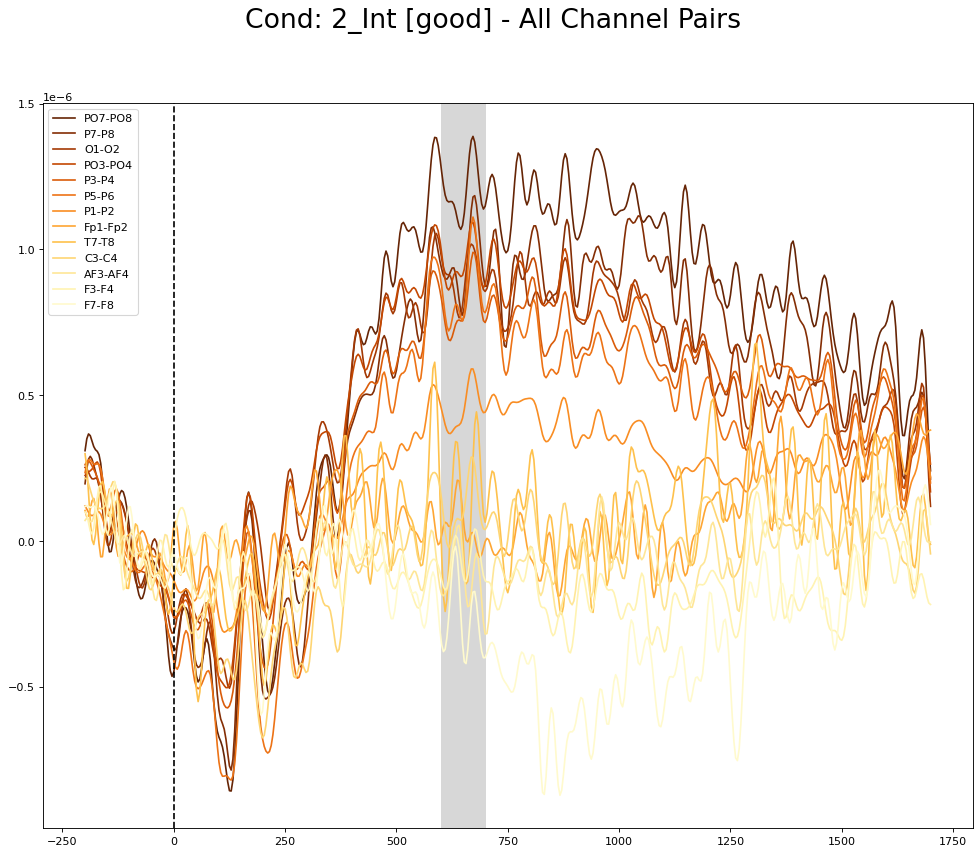

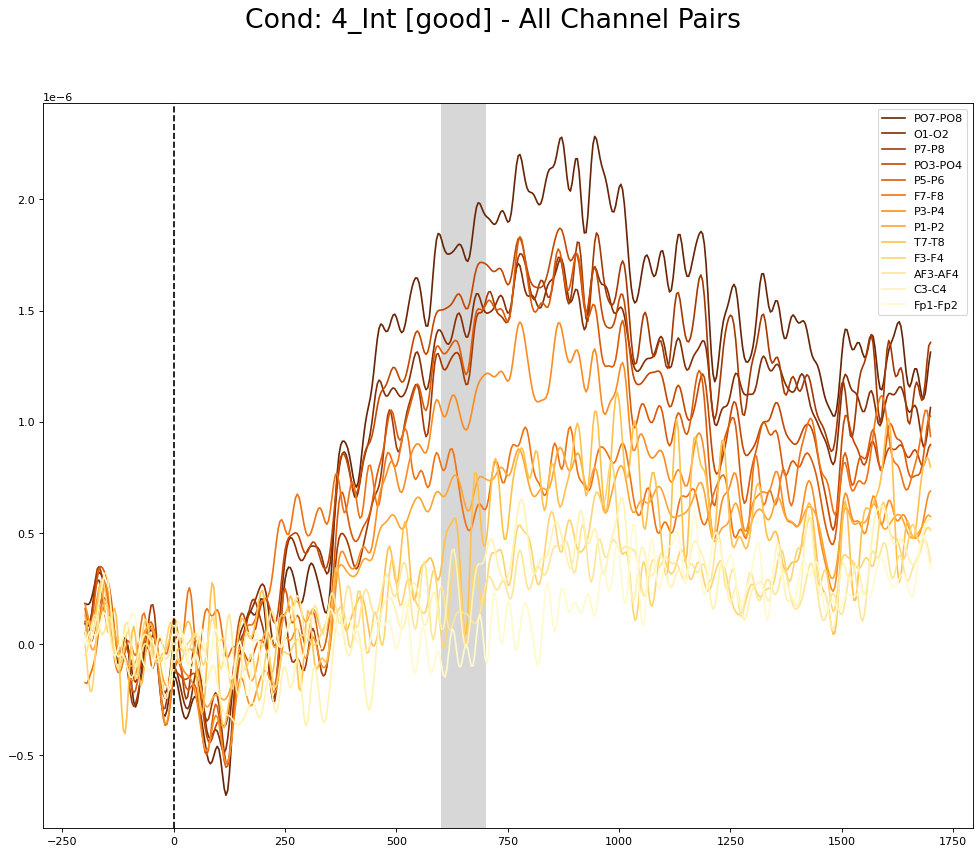

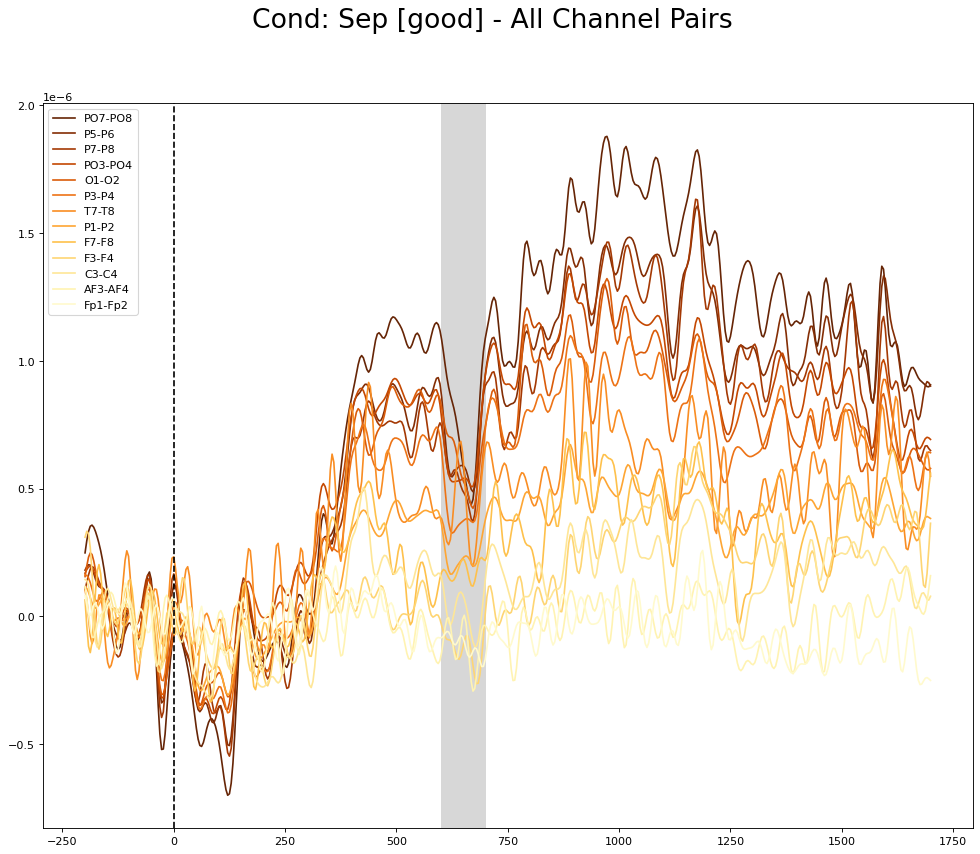

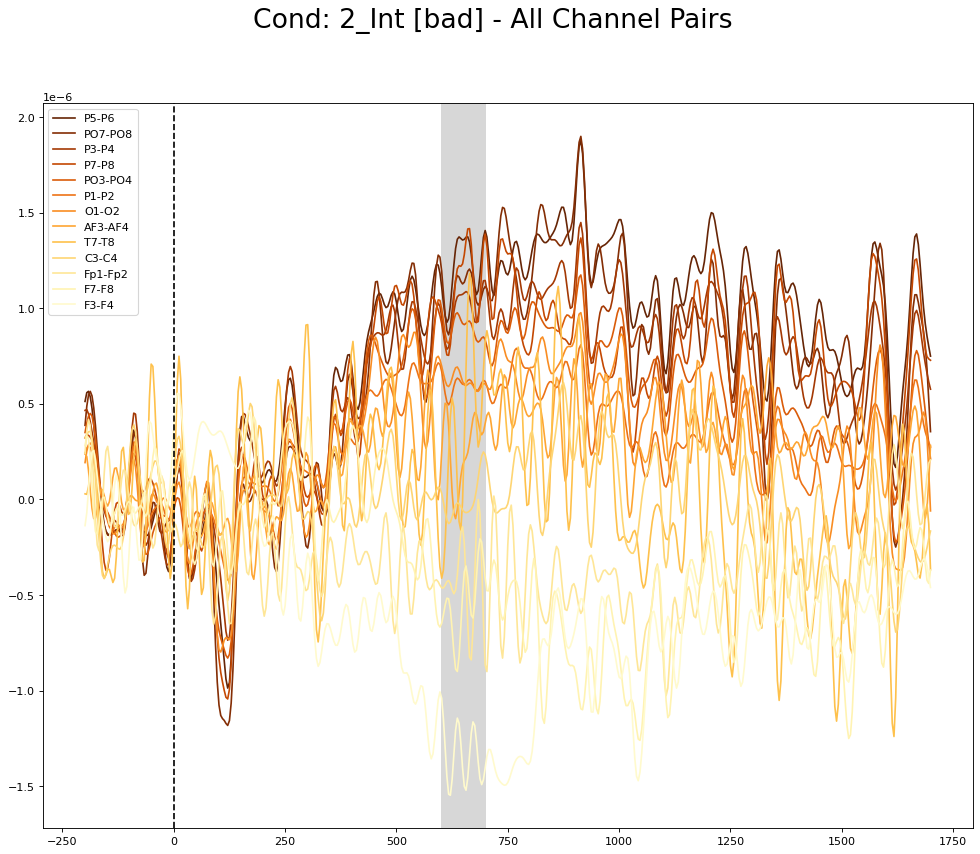

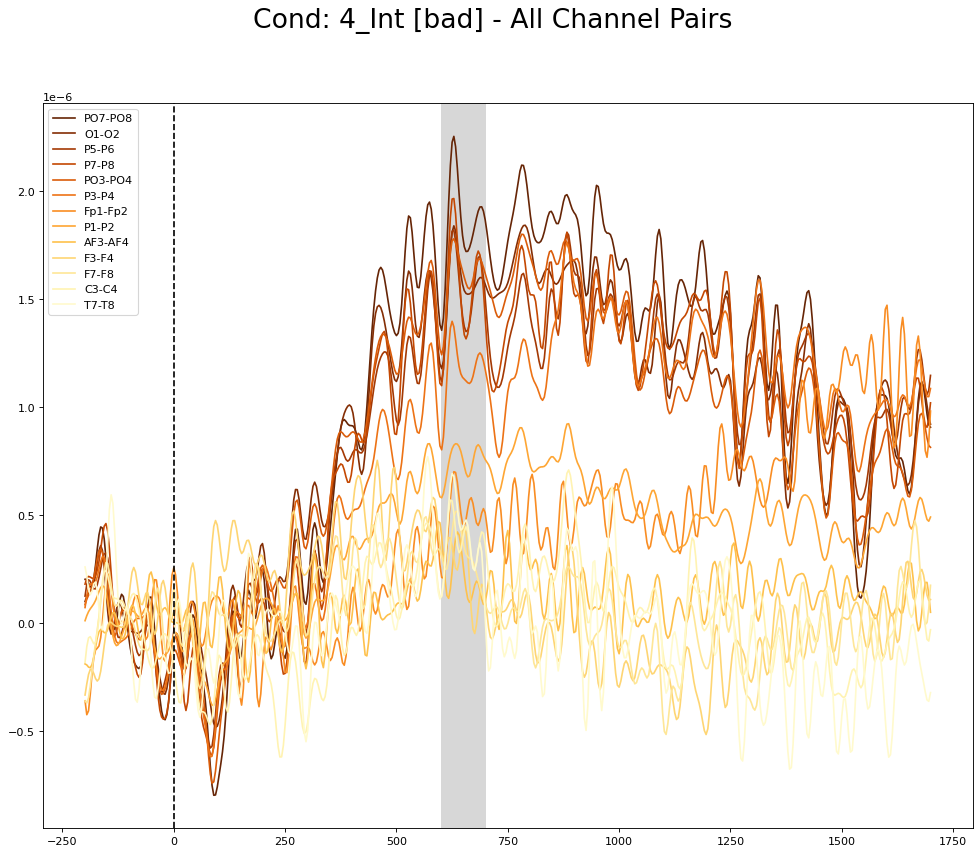

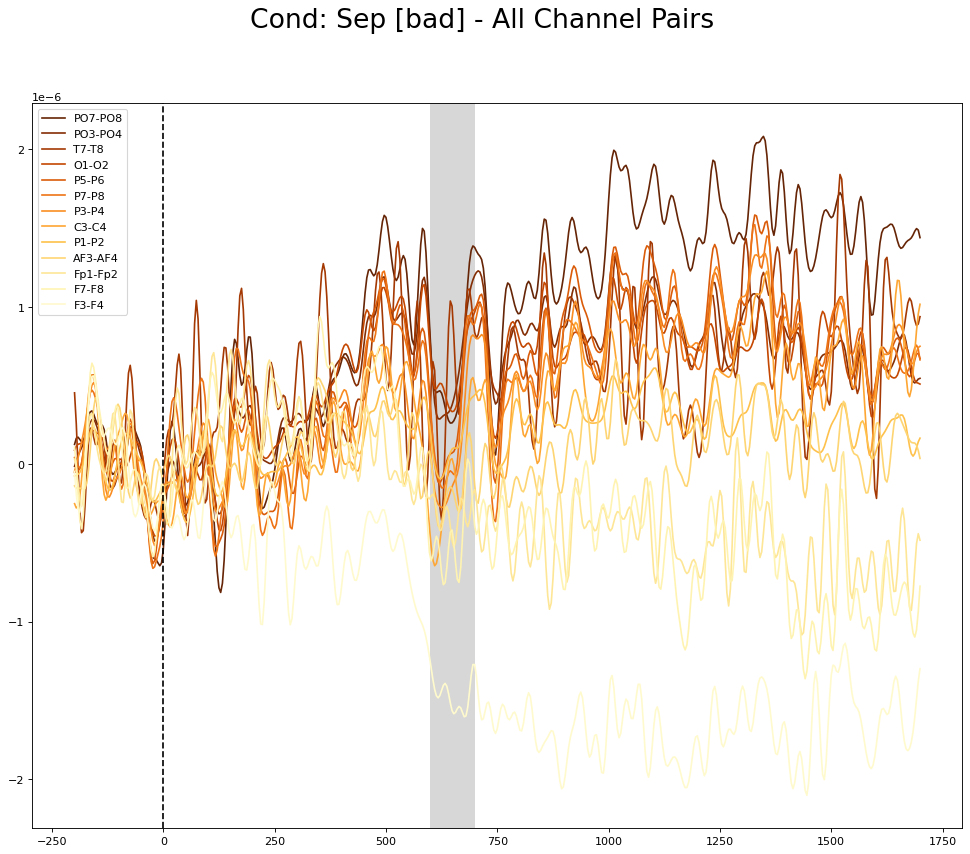

In [11]:
cmap = matplotlib.cm.get_cmap('YlOrBr')

for perf in perfs:
    for cond in conds:
        plt.figure(figsize=(15, 12), dpi=80)
        plt.suptitle("Cond: {} [{}] - All Channel Pairs".format(cond, perf), fontsize=24)

        ch_pair_mean_amp = [cda_all_channels[cond][perf][x].mean(0) for x in cda_all_channels[cond][perf]]
        mean_list, cda_sorted = zip(*sorted(zip(ch_pair_mean_amp, cda_all_channels[cond][perf].items()), reverse=True))

        nb_pairs = len(cda_all_channels[cond][perf].keys())
        for i, ch_pair in enumerate(cda_all_channels[cond][perf].keys()):
            plt.plot((times * 1000), cda_sorted[i][1], label=cda_sorted[i][0], color=cmap(1-i/nb_pairs))

        plt.axvline(x=0, color='k', linestyle='--')
        plt.axvspan(600, 700, alpha=0.9, facecolor='lightgray')
        #plt.gca().invert_yaxis()
        plt.legend()
        plt.show()

### 2.2 Plot CDA - All Channel Pairs (Subject Level / Per Subject)

/var/folders/gn/5c249d_15xb7y6sdl7n8cn9m0000gn/T/ipykernel_19826/4271338620.py:10: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize=(15, 12), dpi=80)


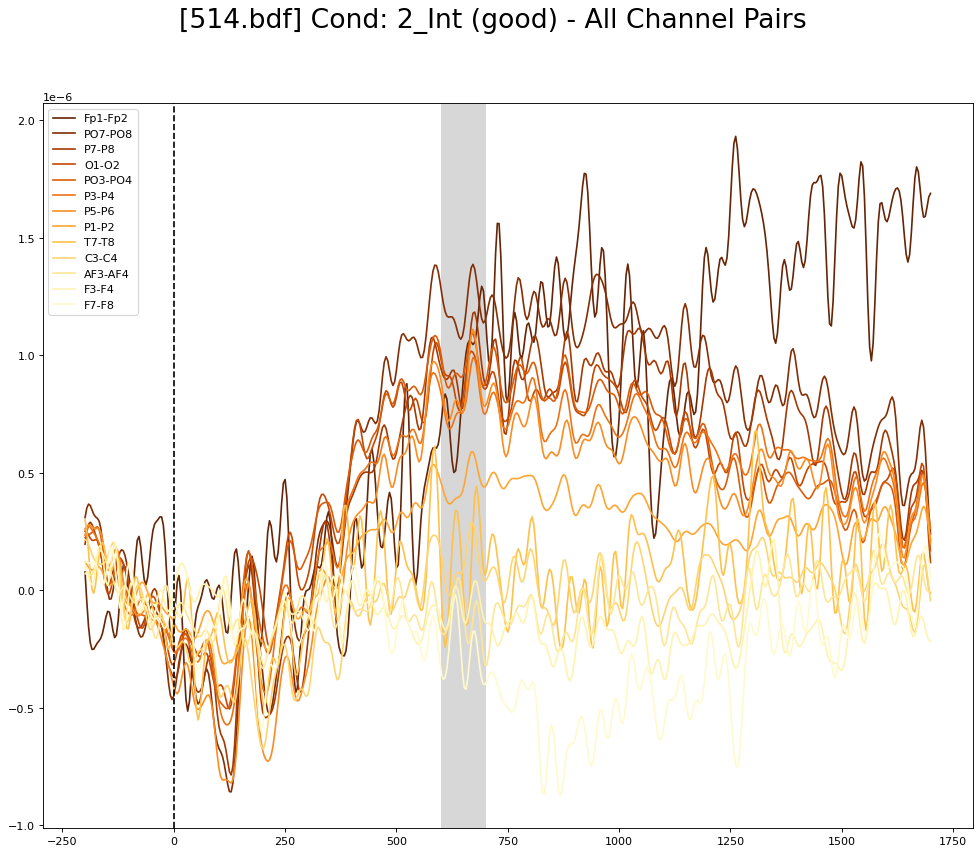

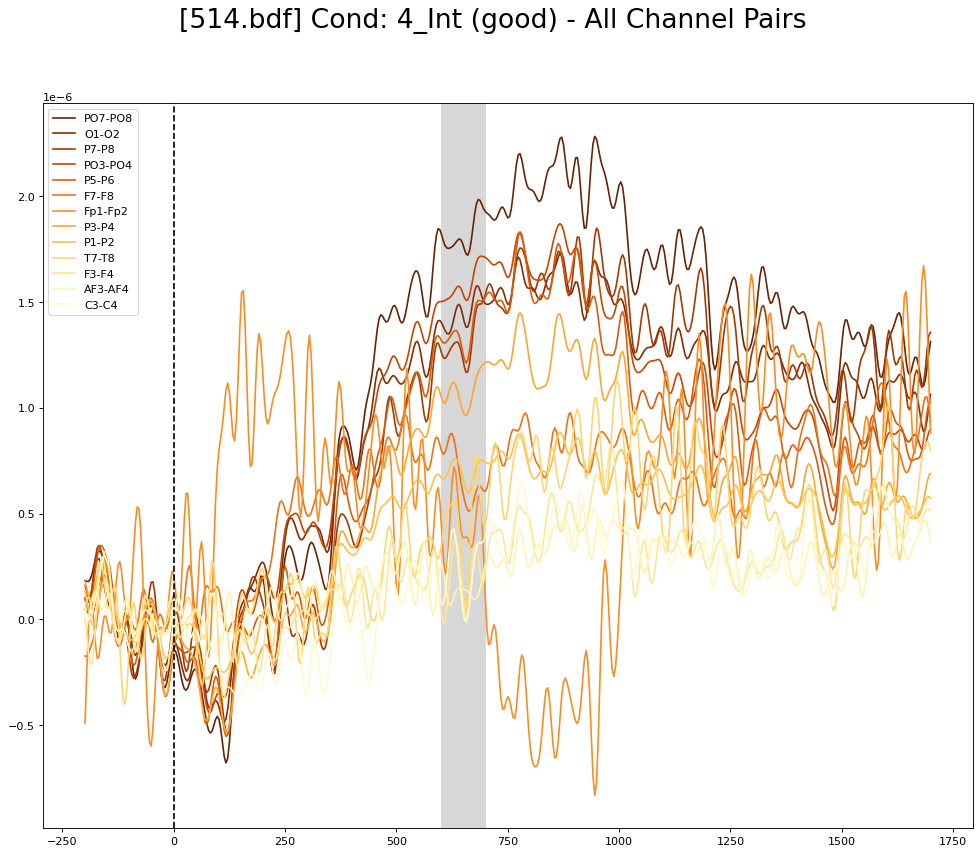

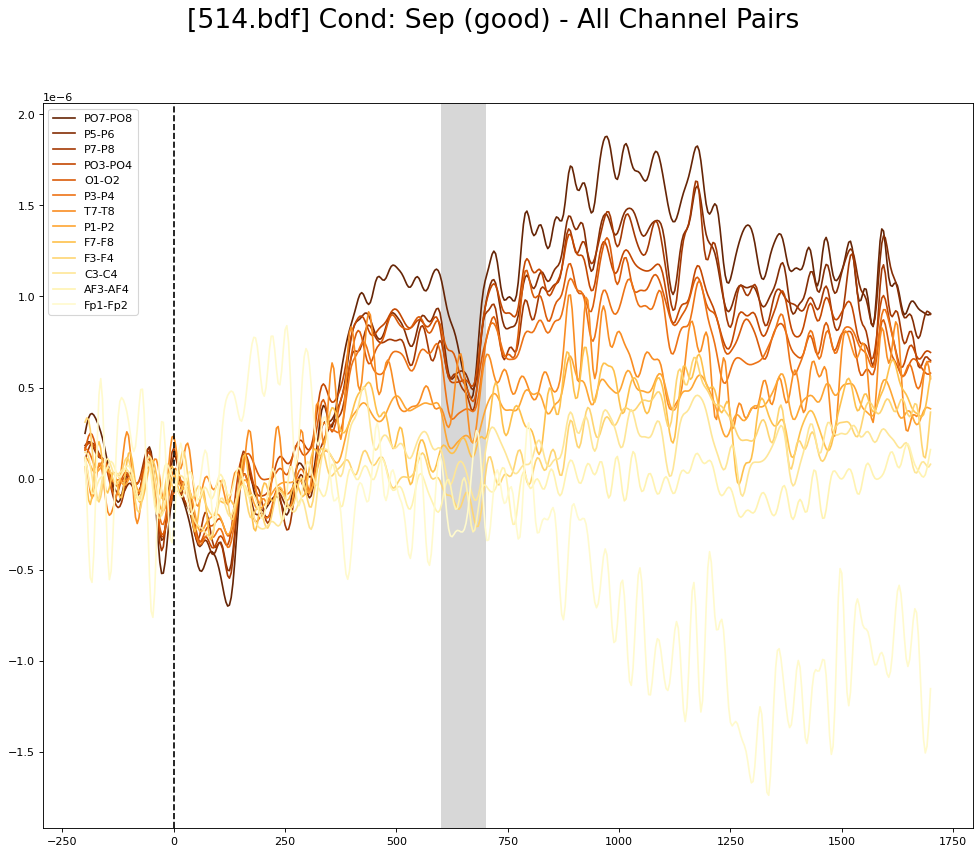

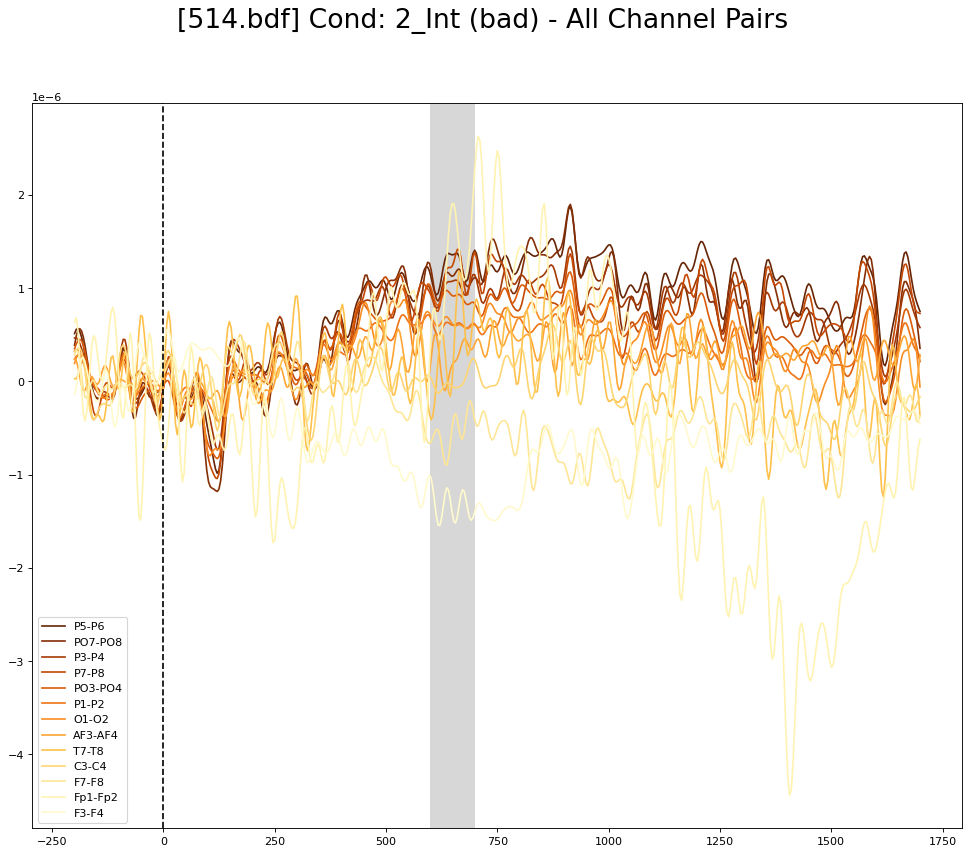

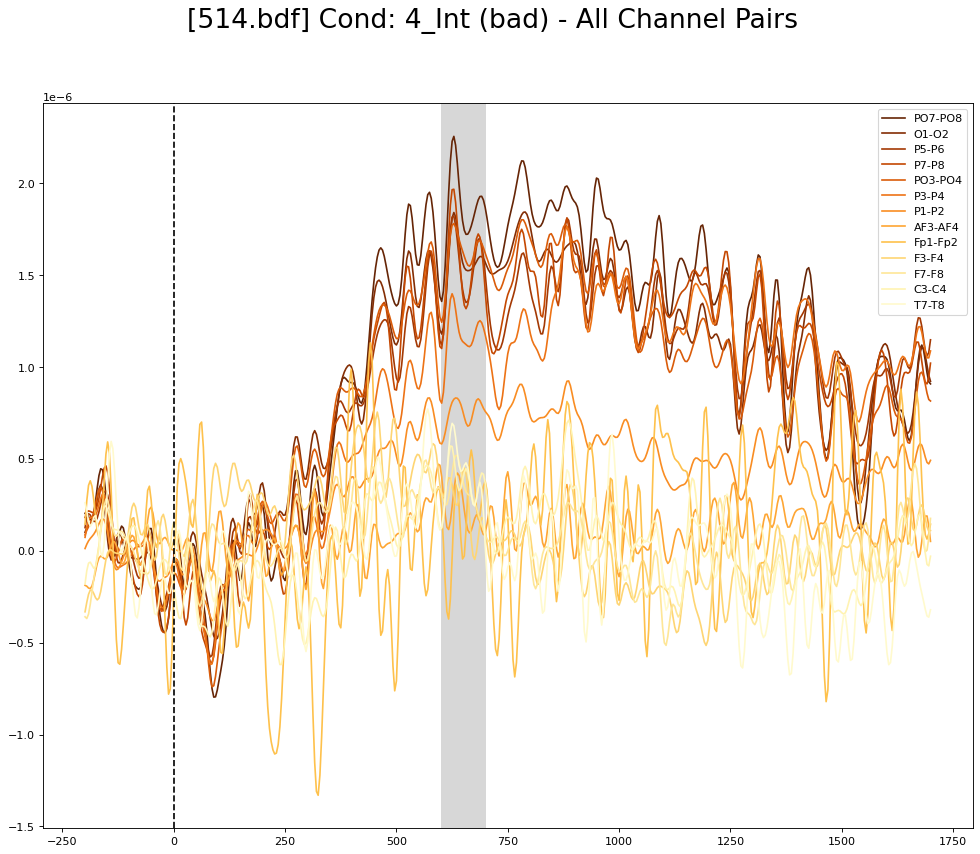

...

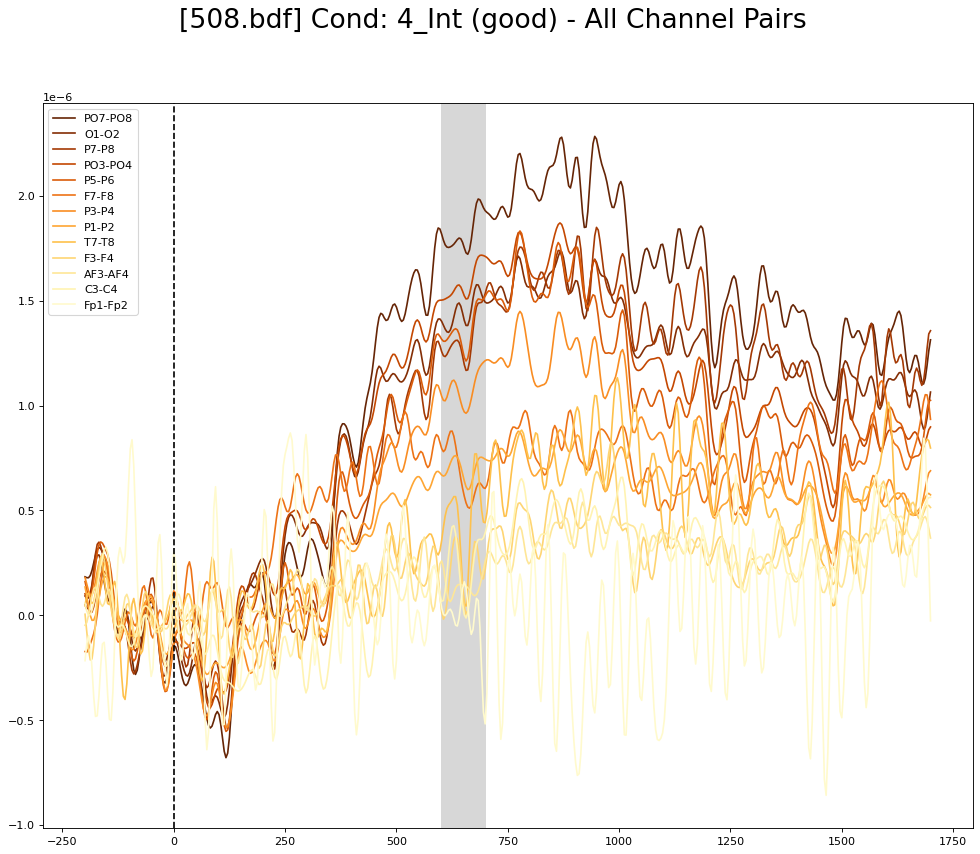

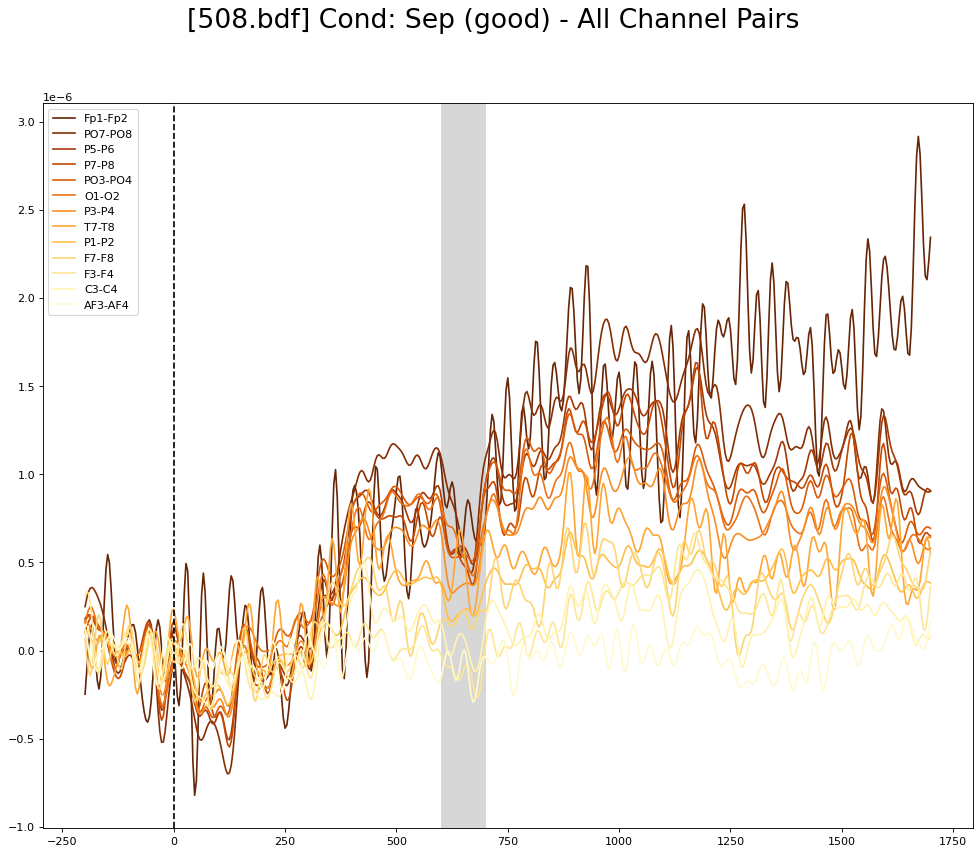

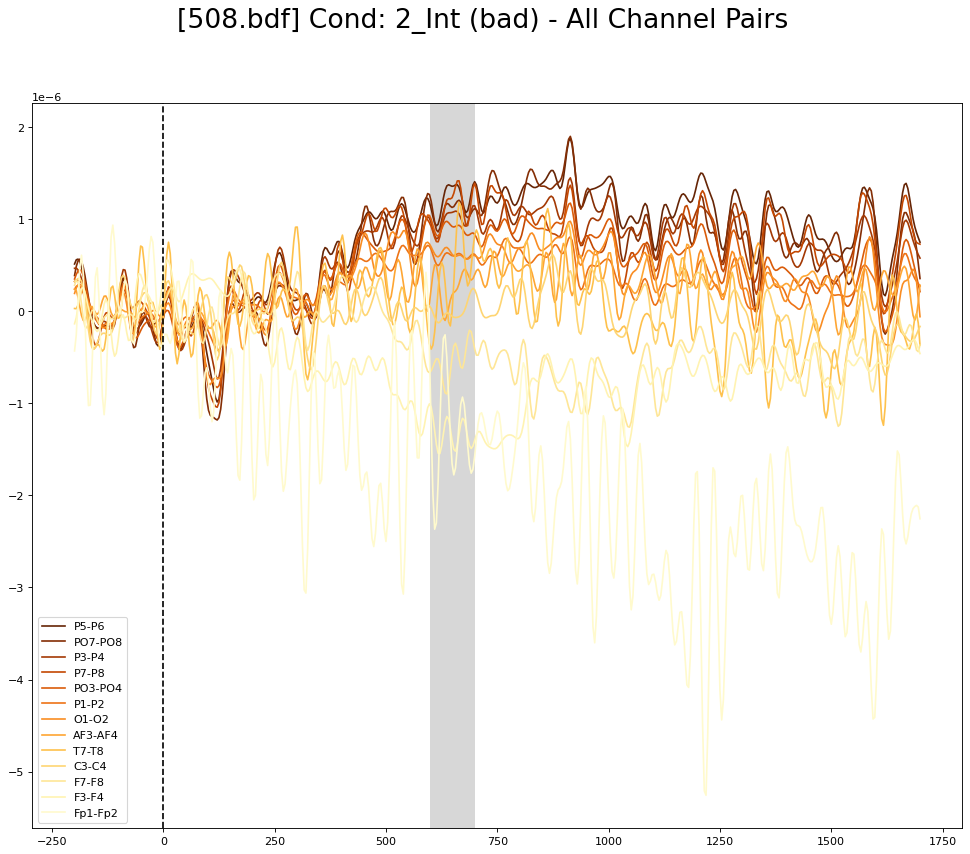

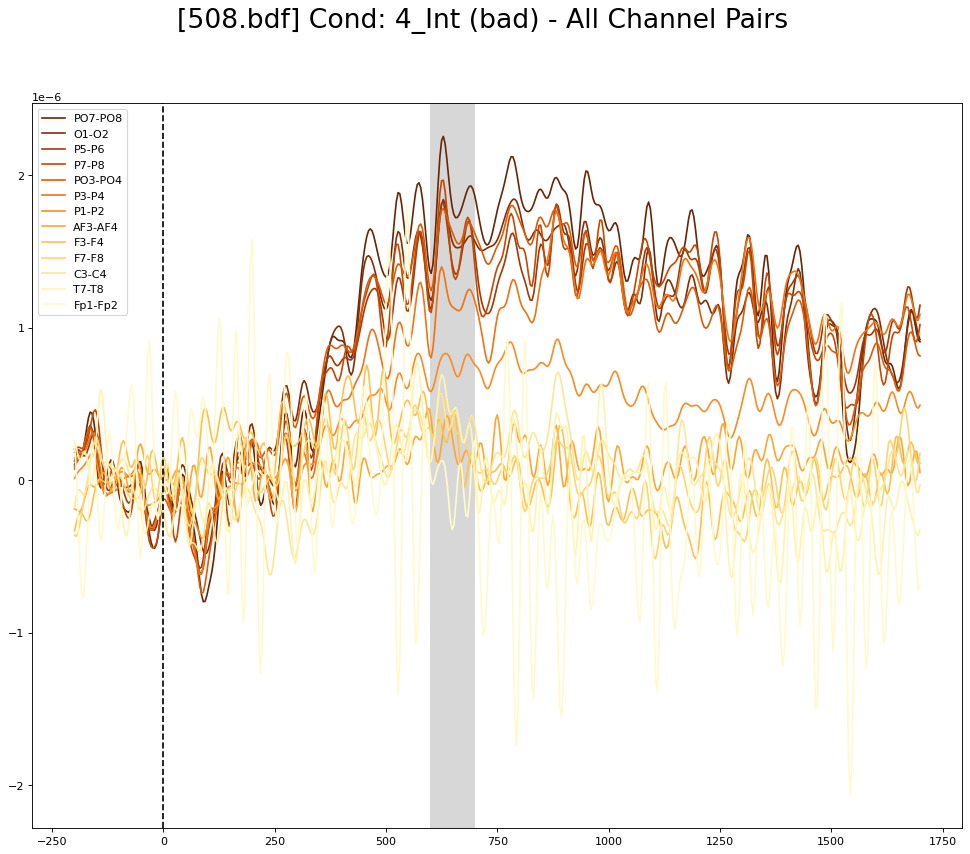

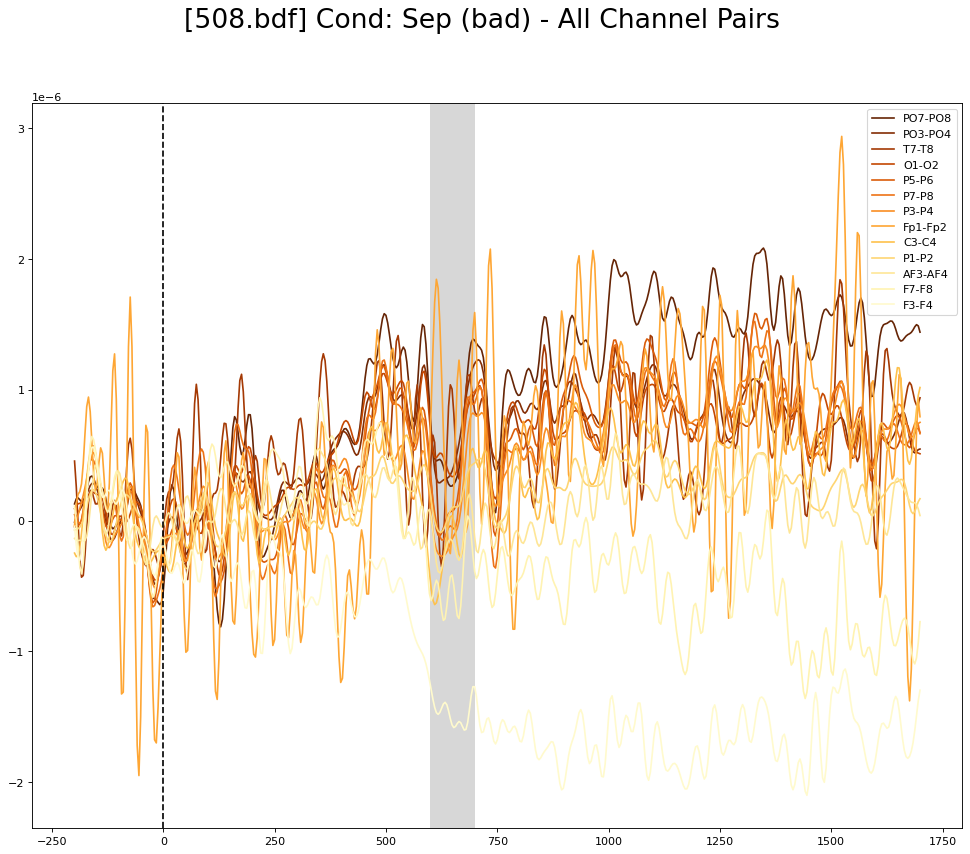

In [12]:
cmap = matplotlib.cm.get_cmap('YlOrBr')

for f in cda_dict.keys():
    for perf in perfs:
        for cond in conds:        
            if len(cda_dict[f][cond]['left'][perf]) > 0:
                cda_dict_cur = (cda_dict[f][cond]['left'][perf] + cda_dict[f][cond]['right'][perf])/2
                cda_all_channels[cond][perf]["{}-{}".format(chan_left_all[i], chan_right_all[i])] = cda_dict_cur

                plt.figure(figsize=(15, 12), dpi=80)
                plt.suptitle("[{}] Cond: {} ({}) - All Channel Pairs".format(f, cond, perf), fontsize=24)

                ch_pair_mean_amp = [cda_all_channels[cond][perf][x].mean(0) for x in cda_all_channels[cond][perf]]
                mean_list, cda_sorted = zip(*sorted(zip(ch_pair_mean_amp, cda_all_channels[cond][perf].items()), reverse=True))

                nb_pairs = len(cda_all_channels[cond][perf].keys())
                for i, ch_pair in enumerate(cda_all_channels[cond][perf].keys()):
                    plt.plot((times * 1000), cda_sorted[i][1], label=cda_sorted[i][0], color=cmap(1-i/nb_pairs))

                plt.axvline(x=0, color='k', linestyle='--')
                plt.axvspan(600, 700, alpha=0.9, facecolor='lightgray')
                #plt.gca().invert_yaxis()
                plt.legend()
                #plt.show()
                plt.savefig("./img/Balaban-2019-Exp2-Channels-{}-{}-{}.jpg".format(f, cond, perf), dpi=300)
            else:
                print("==== SKIPPED: 0 points! (File: {} - Trigger: {})".format(str(f), cond))

### 3 Extra CDA - Midline

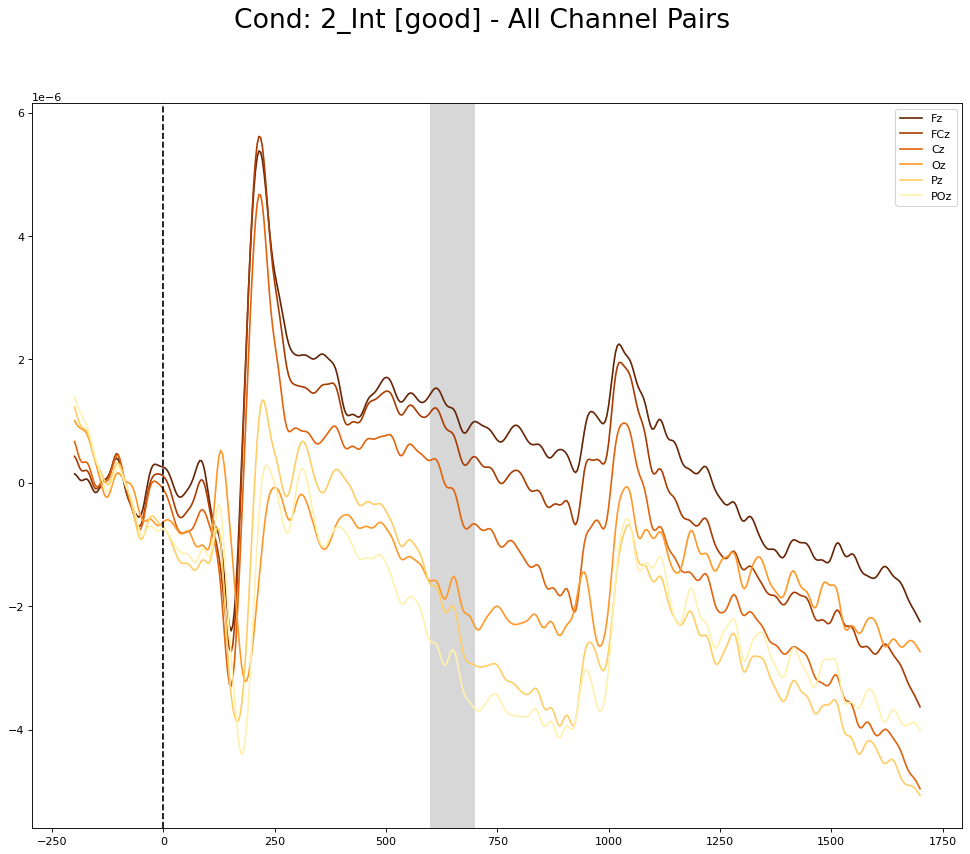

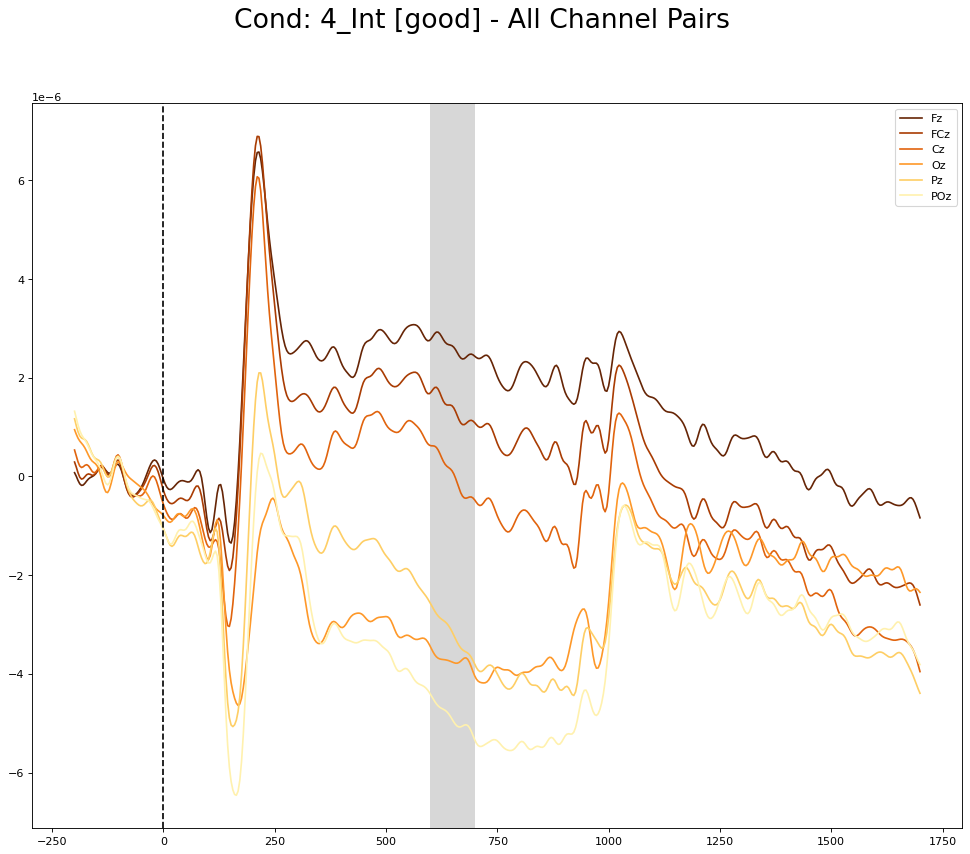

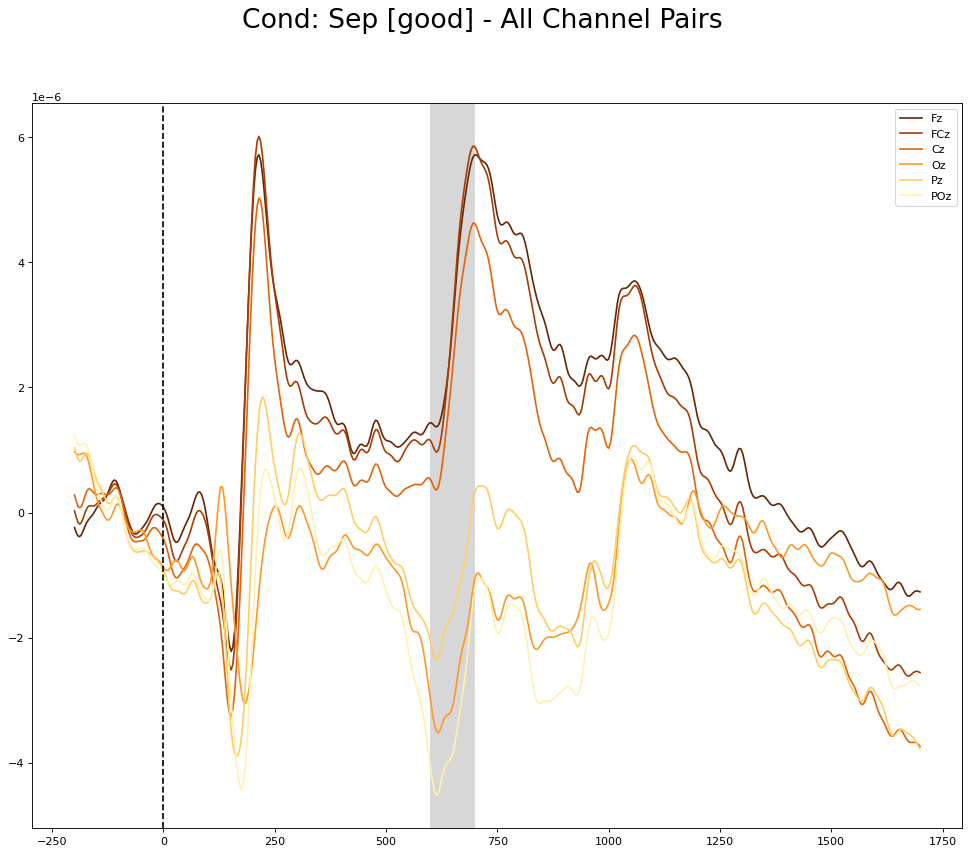

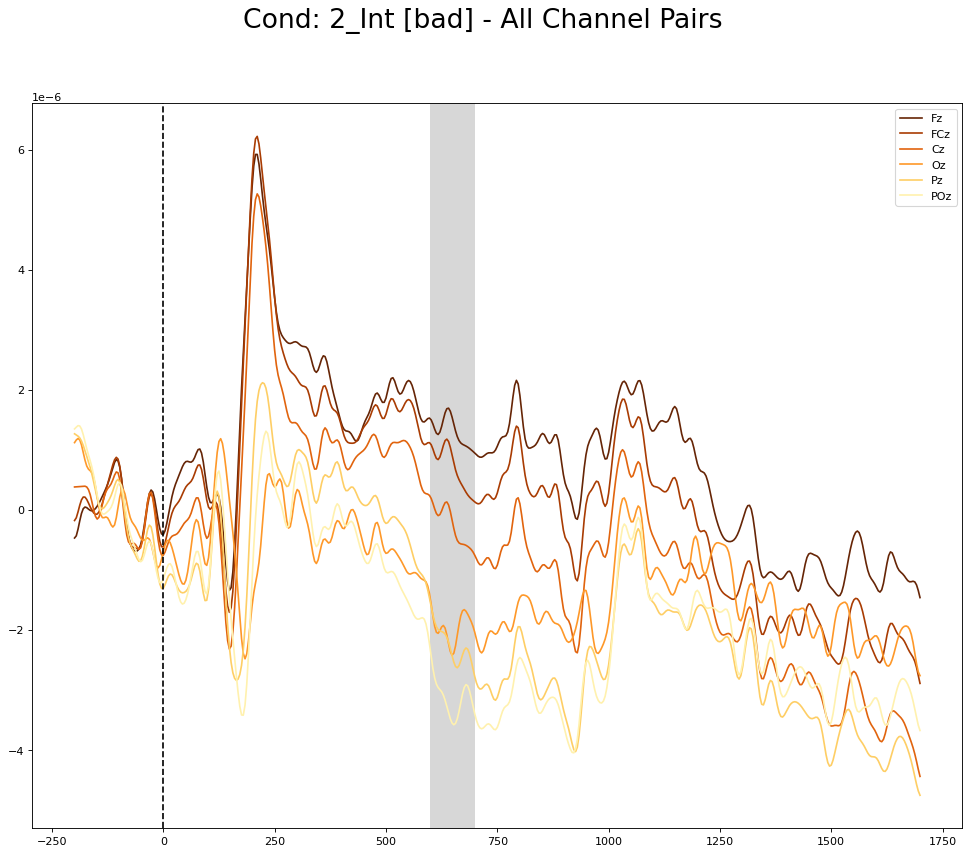

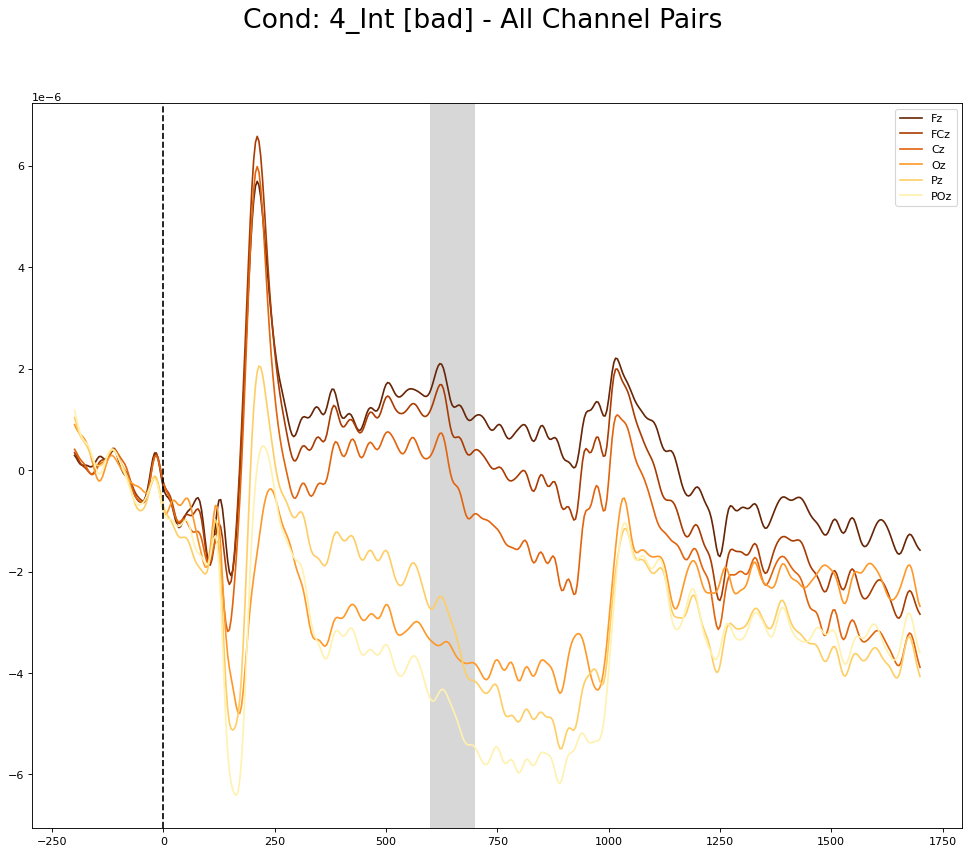

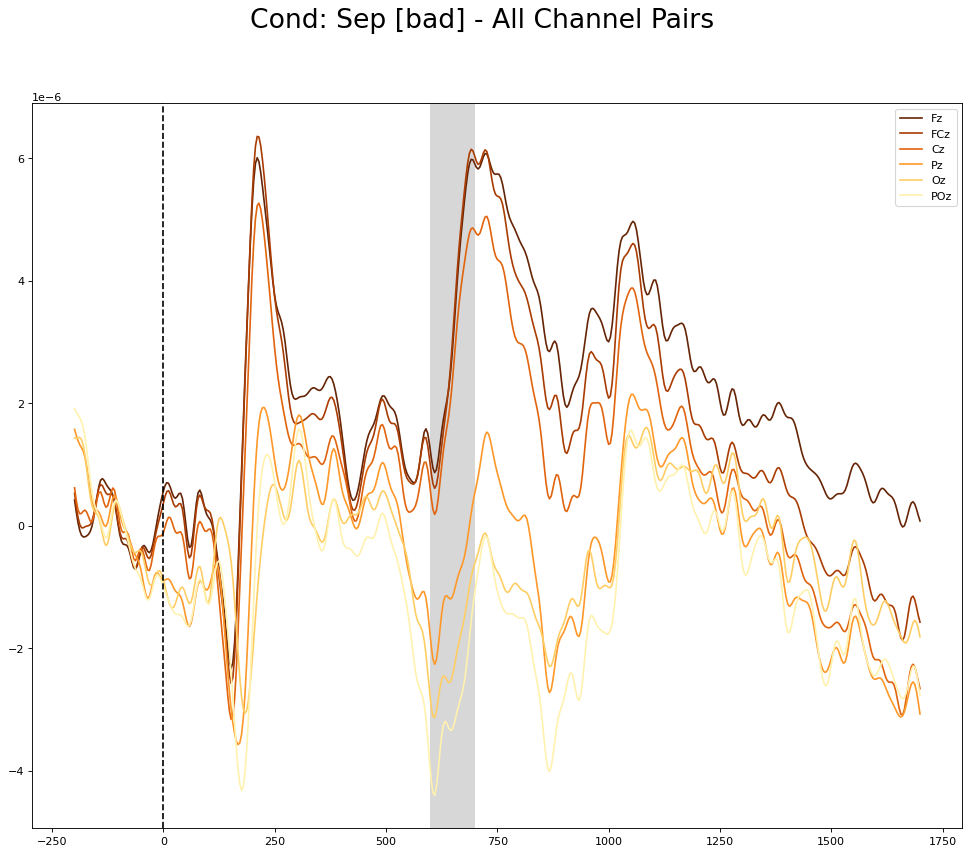

In [13]:
chan_midline_all = ['Fz', 'FCz', 'Cz', 'Pz', 'POz', 'Oz']

cda_midline_dict = dict()
cda_midline_channels = dict()
for cond in conds:
    cda_midline_channels[cond] = dict()
    for perf in perfs:
        cda_midline_channels[cond][perf] = dict()
    
for i, ch in enumerate(chan_midline_all):
    for file_name in epochs_all.keys():
        epochs_dict = epochs_all[file_name]
        cda_midline_dict[file_name] = dict()

        times = epochs_dict[conds[0]][sides[0]][perfs[0]].times

        for cur_cond in conds:
            cda_midline_dict[file_name][cur_cond] = dict()

            for cur_side in sides:
                cda_midline_dict[file_name][cur_cond][cur_side] = dict()

                for cur_perf in perfs:
                    if epochs_dict[cur_cond][cur_side][cur_perf] is not None:
                        epochs_midline = epochs_dict[cur_cond][cur_side][cur_perf].copy().pick_channels([chan_midline_all[i]])
                        evoked_midline = epochs_midline.average()
                        midline = evoked_midline.data.mean(0)

                        cda_midline_dict[file_name][cur_cond][cur_side][cur_perf] = midline
    
    cda_midline_all = dict()

    for cond in cda_midline_dict[list(cda_midline_dict.keys())[0]].keys():
        cda_midline_all[cond] = dict()
        
        for perf in perfs:
            cda_midline_all[cond][perf] = dict()

            for f in cda_dict.keys():
                if len(cda_midline_dict[f][cond]['left'][perf]) > 0:
                    cda_dict_cur = (cda_midline_dict[f][cond]['left'][perf] + cda_midline_dict[f][cond]['right'][perf])/2
                    cda_midline_all[cond][perf] = np.vstack([cda_midline_all[cond][perf], cda_dict_cur]) if len(cda_midline_all[cond][perf]) else cda_dict_cur
                else:
                    print("==== SKIPPED: 0 points! (File: {} - Cond: {} - Perf: {})".format(str(f), str(cond), perf))
        
            cda_midline_channels[cond][perf]["{}".format(chan_midline_all[i])] = cda_midline_all[cond][perf].mean(0)

# Plot
cmap = matplotlib.cm.get_cmap('YlOrBr')

for perf in perfs:
    for cond in conds:
        plt.figure(figsize=(15, 12), dpi=80)
        plt.suptitle("Cond: {} [{}] - All Channel Pairs".format(cond, perf), fontsize=24)

        ch_pair_mean_amp = [cda_midline_channels[cond][perf][x].mean(0) for x in cda_midline_channels[cond][perf]]
        mean_list, cda_sorted = zip(*sorted(zip(ch_pair_mean_amp, cda_midline_channels[cond][perf].items()), reverse=True))

        nb_pairs = len(cda_midline_channels[cond][perf].keys())
        for i, ch_pair in enumerate(cda_midline_channels[cond][perf].keys()):
            plt.plot((times * 1000), cda_sorted[i][1], label=cda_sorted[i][0], color=cmap(1-i/nb_pairs))

        plt.axvline(x=0, color='k', linestyle='--')
        plt.axvspan(600, 700, alpha=0.9, facecolor='lightgray')
        #plt.gca().invert_yaxis()
        plt.legend()
        #plt.show()
        plt.savefig("./img/Balaban-2019-Exp1-Channels-Midline-{}-{}.jpg".format(cond, perf), dpi=300)
